In [ ]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from diffusers import StableDiffusionPipeline, DDIMScheduler
from PIL import Image

In [ ]:
# Define model and load DDIM scheduler from the pretrained model repository
model_id = "CompVis/stable-diffusion-v1-4"
scheduler = DDIMScheduler.from_pretrained(model_id, subfolder="scheduler", timestep_spacing="trailing") # DDIMScheduler
pipe = StableDiffusionPipeline.from_pretrained(model_id, scheduler=scheduler)
pipe = pipe.to("cuda")

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


scheduler_config.json:   0%|          | 0.00/313 [00:00<?, ?B/s]

model_index.json:   0%|          | 0.00/541 [00:00<?, ?B/s]

Fetching 14 files:   0%|          | 0/14 [00:00<?, ?it/s]

Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`
Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/592 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/4.56k [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/806 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`
Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/551 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

config.json:   0%|          | 0.00/743 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [ ]:
# Set up generation parameters
c_1 = "a man"
c_2 = "a forest"
prompt_2 = f"A solhouette photo of {c_1}."
prompt_1 = f"A photo of {c_2}."
negative_prompt = ""
num_inference_steps = 30  # total denoising steps
height = 512               # output image height
width = 512                # output image width
seed = 2147483

guidance_scale_1 = 7.5       # classifier-free guidance strength
def guidance_scale_1_fn(t):
    # if t>=900:
    #     return 2
    # else:
    #     return 7.5
    return 7.5
guidance_scale_2 = 7.5       # classifier-free guidance strength
def guidance_scale_2_fn(t):
    # if t>=950:
    #     return 10
    # else:
    #     return 7.5
    return 7.5

In [ ]:
# --- Prepare text embeddings ---
# Tokenize and encode the prompt
text_input_1 = pipe.tokenizer(
    prompt_1,
    padding="max_length",
    max_length=pipe.tokenizer.model_max_length,
    truncation=True,
    return_tensors="pt"
)
text_embeddings_1 = pipe.text_encoder(text_input_1.input_ids.to(pipe.device))[0]
text_input_2 = pipe.tokenizer(
    prompt_2,
    padding="max_length",
    max_length=pipe.tokenizer.model_max_length,
    truncation=True,
    return_tensors="pt"
)
text_embeddings_2 = pipe.text_encoder(text_input_2.input_ids.to(pipe.device))[0]

# For classifier-free guidance, also get unconditional embeddings
uncond_input = pipe.tokenizer(
    [negative_prompt],
    padding="max_length",
    max_length=pipe.tokenizer.model_max_length,
    return_tensors="pt"
)
uncond_embeddings = pipe.text_encoder(uncond_input.input_ids.to(pipe.device))[0]
# Concatenate unconditional and conditional embeddings
context = torch.cat([uncond_embeddings, text_embeddings_1, text_embeddings_2])

In [ ]:
# Set timesteps for DDIM scheduler
scheduler.set_timesteps(num_inference_steps)


# --- Prepare initial latent noise ---
# The latent shape is (batch, channels, height//8, width//8)
rng = torch.Generator(device=pipe.device)
rng.manual_seed(seed)
noise = torch.randn(
    # (512, 512, 3) -> (64, 64, 4) the size unet gonna dealwith
    (1, pipe.unet.config.in_channels, height // 8, width // 8),
    device=pipe.device,
    generator=rng,
)
latents = noise

# Scale by scheduler’s initial noise sigma
latents = latents * scheduler.init_noise_sigma

# Lists to store intermediate outputs (for further inspection if desired)
intermediate_noises = []
intermediate_latents = []
intermediate_blended = []
intermediate_masks = []
intermediate_predoriginal_uncond = []
intermediate_predoriginal_text_1 = []
intermediate_predoriginal_text_2 = []
intermediate_predoriginal_1 = []
intermediate_predoriginal_2 = []
intermediate_predoriginal = []

Step 0/30
Mixing factor = 0.7733333333333334


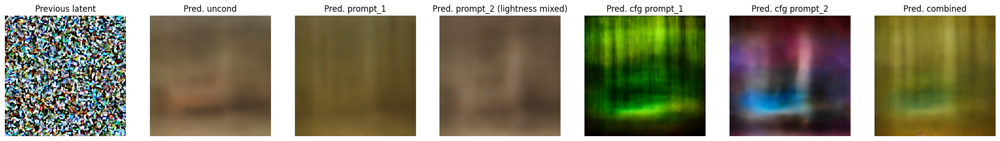

Step 1/30
Mixing factor = 0.7466666666666668


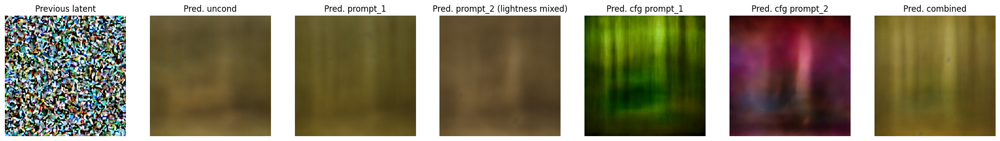

Step 2/30
Mixing factor = 0.7200000000000002


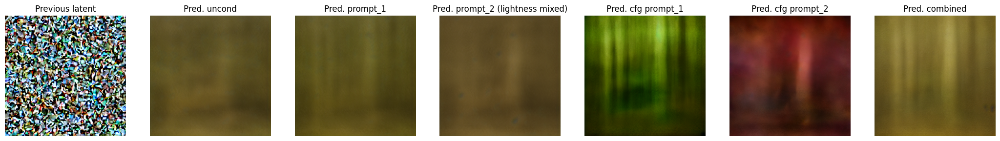

Step 3/30
Mixing factor = 0.6933333333333336


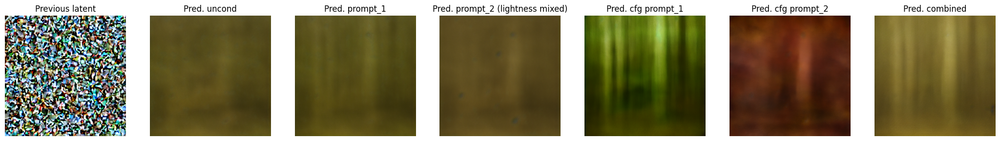

Step 4/30
Mixing factor = 0.666666666666667


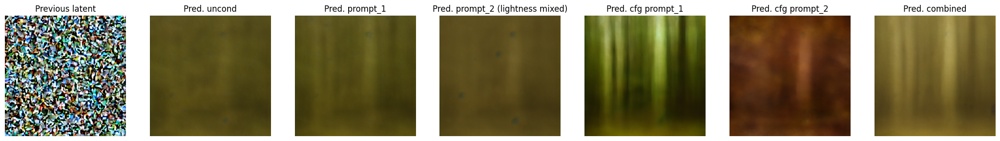

Step 5/30
Mixing factor = 0.6400000000000003


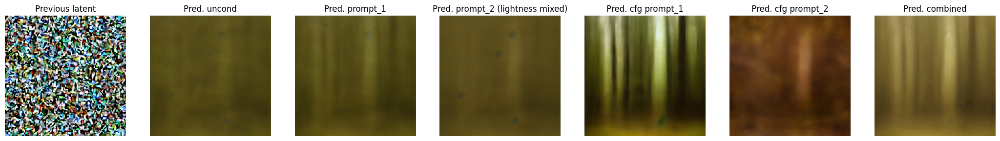

Step 6/30
Mixing factor = 0.6133333333333337


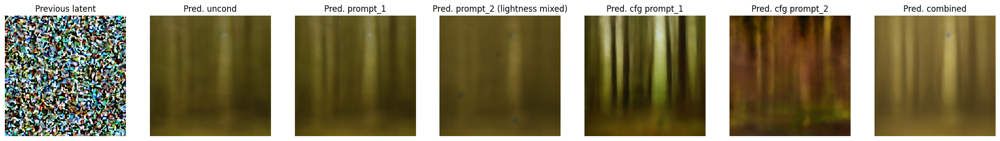

Step 7/30
Mixing factor = 0.5866666666666671


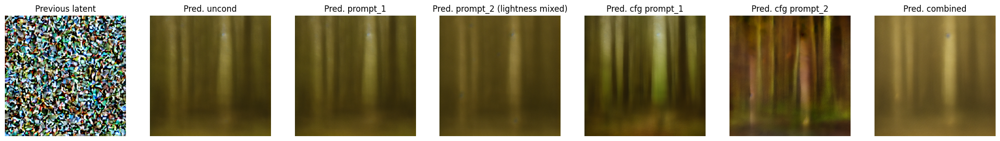

Step 8/30
Mixing factor = 0.5600000000000005


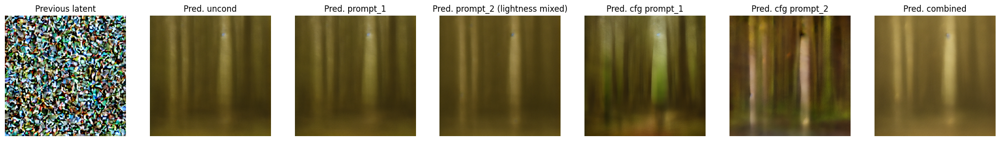

Step 9/30
Mixing factor = 0.5333333333333339


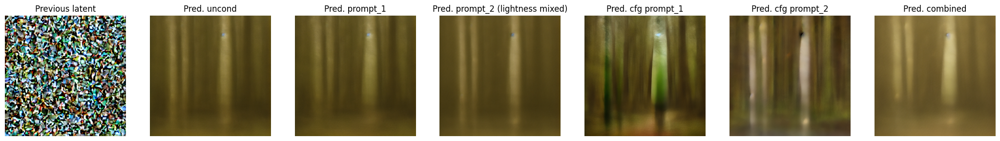

Step 10/30
Mixing factor = 0.5066666666666673


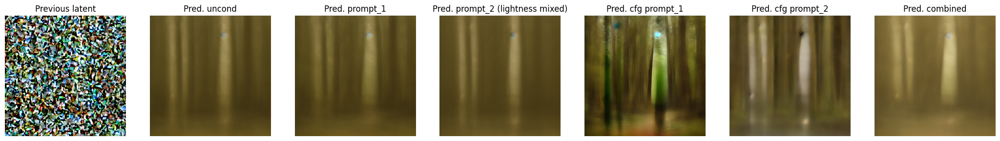

Step 11/30
Mixing factor = 0.4800000000000006


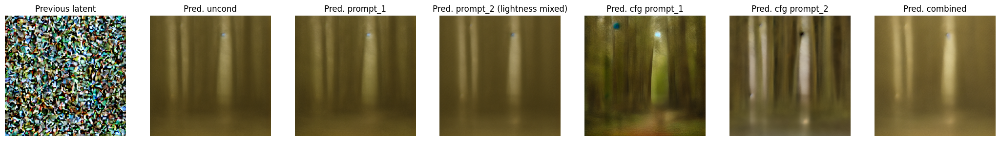

Step 12/30
Mixing factor = 0.4533333333333339


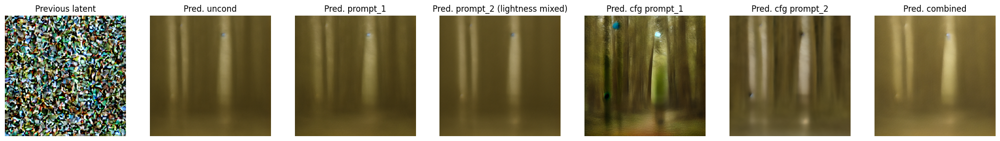

Step 13/30
Mixing factor = 0.42666666666666725


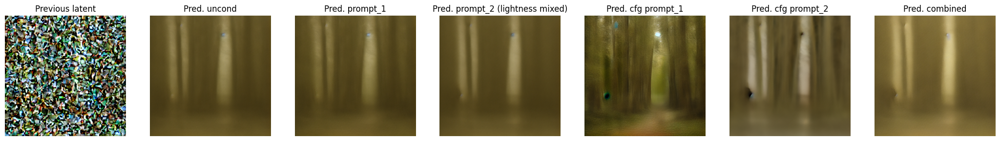

Step 14/30
Mixing factor = 0.4000000000000006


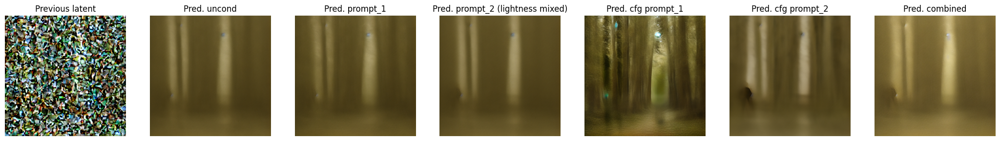

Step 15/30
Mixing factor = 0.3733333333333339


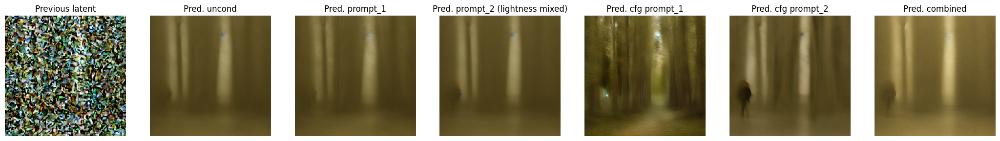

Step 16/30
Mixing factor = 0.34666666666666723


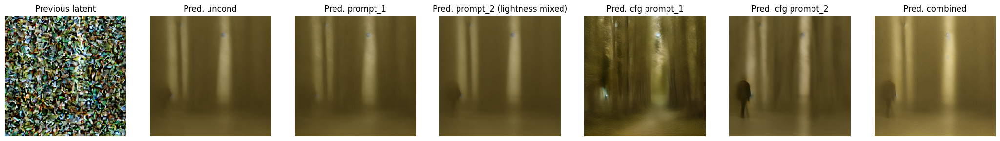

Step 17/30
Mixing factor = 0.32000000000000056


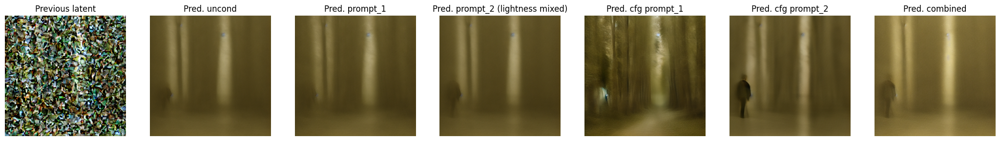

Step 18/30
Mixing factor = 0.2933333333333339


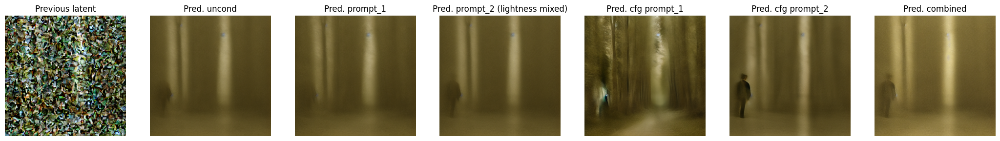

Step 19/30
Mixing factor = 0.2666666666666672


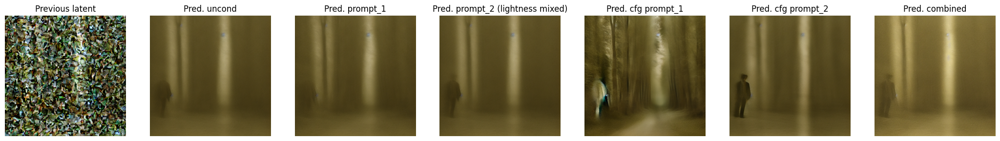

Step 20/30
Mixing factor = 0.24000000000000055


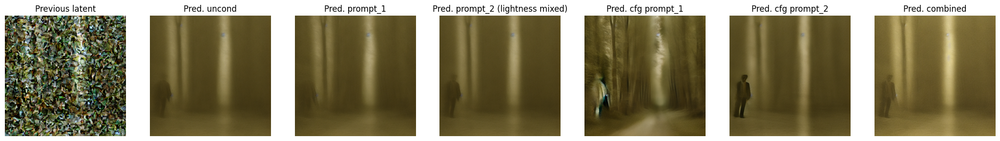

Step 21/30
Mixing factor = 0.21333333333333387


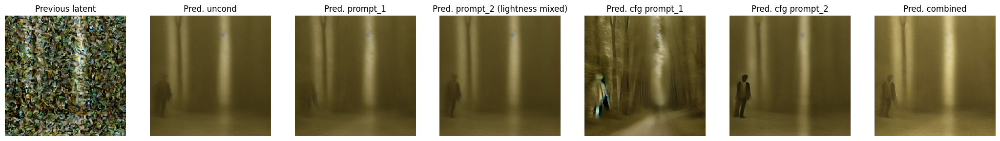

Step 22/30
Mixing factor = 0.1866666666666672


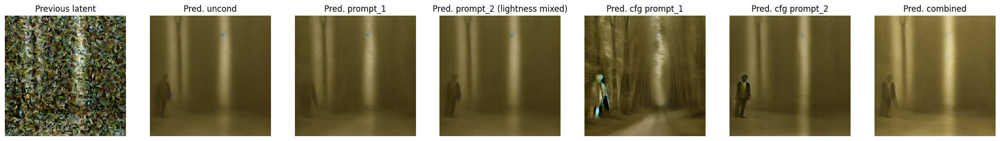

Step 23/30
Mixing factor = 0.16000000000000053


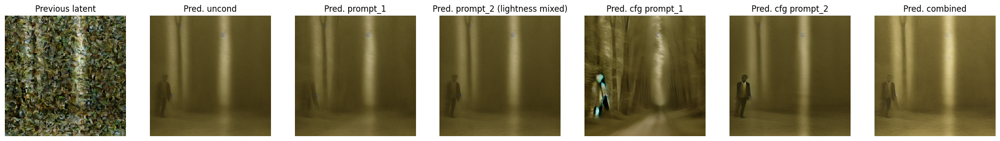

Step 24/30
Mixing factor = 0.13333333333333386


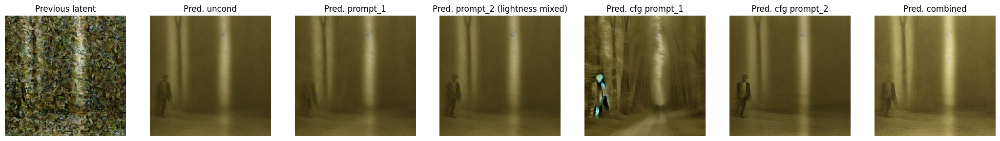

Step 25/30
Mixing factor = 0.10666666666666719


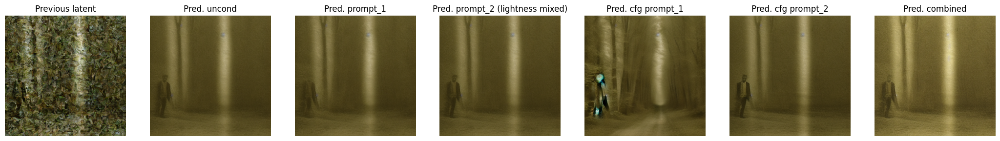

Step 26/30
Mixing factor = 0.08000000000000052


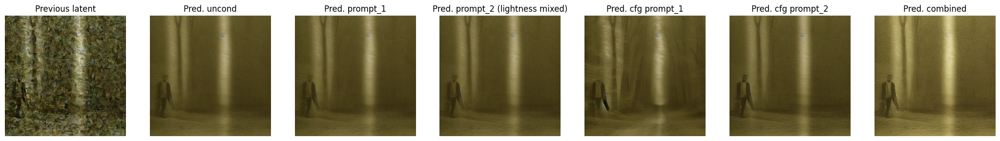

Step 27/30
Mixing factor = 0.05333333333333384


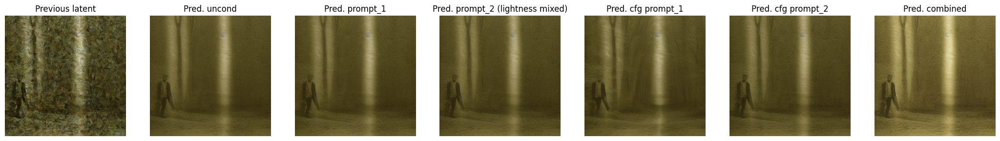

Step 28/30
Mixing factor = 0.026666666666667175


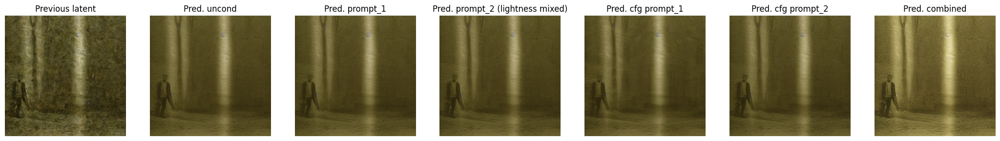

Step 29/30
Mixing factor = 5.065392549852277e-16


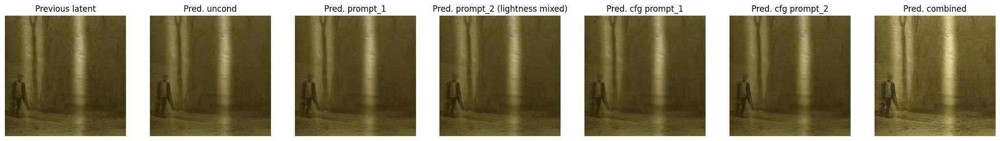

In [ ]:
# Add necessary imports at the top of your script
import numpy as np
from skimage import color
from skimage.color import rgb2lab, lab2rgb # These are already in your original code
import torch # Ensure torch is imported
from PIL import Image # Ensure PIL is imported

# Assume 'scheduler', 'latents', 'pipe', 'context', 'guidance_scale_1', 'guidance_scale_2'
# are defined and initialized before this loop.
# Also, ensure intermediate_latents, intermediate_predoriginal, etc. are initialized as empty lists.

total_steps = len(scheduler.timesteps)

# Initialize mixing factor
mixing_factor = 0.8
final_mixing_factor = 0.2
decresing_step = (mixing_factor - final_mixing_factor) / total_steps

# Initialize lists for storing intermediate images (if not already done elsewhere)
intermediate_latents = []
intermediate_predoriginal = []
intermediate_predoriginal_1 = []
intermediate_predoriginal_2 = []
intermediate_predoriginal_text_1 = []
intermediate_predoriginal_text_2 = []
intermediate_predoriginal_uncond = []


for i, t in enumerate(scheduler.timesteps):
    # For classifier-free guidance, we need to duplicate latents
    latent_input = torch.cat([latents] * 3)
    latent_input = scheduler.scale_model_input(latent_input, t)

    # Predict noise residual using the U-Net model
    with torch.no_grad():
        noise_pred = pipe.unet(latent_input, t, encoder_hidden_states=context).sample

    # Now we can separate predictions
    noise_pred_uncond, noise_pred_text_1, noise_pred_text_2 = noise_pred.chunk(3)

    # Calculate all prediction variants (needed for visualization)
    # These are latent space predictions of the original sample before any blending
    pred_original_sample_uncond = scheduler.step(noise_pred_uncond, t, latents).pred_original_sample
    pred_original_sample_text_1 = scheduler.step(noise_pred_text_1, t, latents).pred_original_sample
    pred_original_sample_text_2 = scheduler.step(noise_pred_text_2, t, latents).pred_original_sample

    noise_pred_1 = noise_pred_uncond + guidance_scale_1 * (noise_pred_text_1 - noise_pred_uncond)
    noise_pred_2 = noise_pred_uncond + guidance_scale_2 * (noise_pred_text_2 - noise_pred_uncond)

    step_output_1 = scheduler.step(noise_pred_1, t, latents)
    step_output_2 = scheduler.step(noise_pred_2, t, latents)

    # Core latent space blending for the next step's input
    latents = step_output_1.prev_sample * mixing_factor + step_output_2.prev_sample * (1 - mixing_factor)

    # Initial blend of pred_original_sample in latent space (what the model predicted based on mixed noise)
    pred_original_sample_latent_mix = step_output_1.pred_original_sample * mixing_factor + step_output_2.pred_original_sample * (1 - mixing_factor)


    # These remain the raw predictions from each prompt for separate visualization
    pred_original_sample_1 = step_output_1.pred_original_sample
    pred_original_sample_2 = step_output_2.pred_original_sample

    mixing_factor -= decresing_step

    # --- Decode the current latents to image ---
    latent_for_decode = 1 / 0.18215 * latents
    with torch.no_grad():
        image_tensor = pipe.vae.decode(latent_for_decode).sample
    image_tensor = (image_tensor / 2 + 0.5).clamp(0, 1)
    image_array = image_tensor.cpu().permute(0, 2, 3, 1).numpy()[0]
    image_array = (255 * image_array).round().astype("uint8")
    pil_image = Image.fromarray(image_array)
    intermediate_latents.append(pil_image)

    # --- Decode the predicted clean latent to image (THIS ONE NOW INCLUDES LIGHTNESS BLEND IN PHASE 2) ---
    latent_for_decode = 1 / 0.18215 * pred_original_sample # This is the refined/blended pred_original_sample
    with torch.no_grad():
        image_tensor = pipe.vae.decode(latent_for_decode).sample
    image_tensor = (image_tensor / 2 + 0.5).clamp(0, 1)
    image_array = image_tensor.cpu().permute(0, 2, 3, 1).numpy()[0]
    image_array = (255 * image_array).round().astype("uint8")
    pil_image = Image.fromarray(image_array)
    intermediate_predoriginal.append(pil_image)

    # --- Decode the predicted clean latent for the first image (from prompt 1 alone) ---
    latent_for_decode = 1 / 0.18215 * pred_original_sample_1
    with torch.no_grad():
        image_tensor = pipe.vae.decode(latent_for_decode).sample
    image_tensor = (image_tensor / 2 + 0.5).clamp(0, 1)
    image_array = image_tensor.cpu().permute(0, 2, 3, 1).numpy()[0]
    image_array = (255 * image_array).round().astype("uint8")
    pil_image = Image.fromarray(image_array)
    intermediate_predoriginal_1.append(pil_image)

    # --- Decode predicted clean latent for the second image (from prompt 2 alone) ---
    latent_for_decode = 1 / 0.18215 * pred_original_sample_2
    with torch.no_grad():
        image_tensor = pipe.vae.decode(latent_for_decode).sample
    image_tensor = (image_tensor / 2 + 0.5).clamp(0, 1)
    image_array_2 = image_tensor.cpu().permute(0, 2, 3, 1).numpy()[0]
    image_array_2 = (255 * image_array_2).round().astype("uint8") # Convert to uint8 for PIL
    pil_image = Image.fromarray(image_array_2)
    intermediate_predoriginal_2.append(pil_image)

    # --- Decode the first image (from original pred_original_sample_text_1 for separate visualization) ---
    latent_for_decode = 1 / 0.18215 * pred_original_sample_text_1
    with torch.no_grad():
        image_tensor = pipe.vae.decode(latent_for_decode).sample
    image_tensor = (image_tensor / 2 + 0.5).clamp(0, 1)
    image_array = image_tensor.cpu().permute(0, 2, 3, 1).numpy()[0]
    # 'first_image_array' was a temporary variable for the blend before, now it's just for visualization
    first_image_array = image_array.copy()
    image_array = (255 * image_array).round().astype("uint8")
    pil_image = Image.fromarray(image_array)
    intermediate_predoriginal_text_1.append(pil_image)

    # --- Decode the second image (from original pred_original_sample_text_2 for separate visualization) ---
    latent_for_decode = 1 / 0.18215 * pred_original_sample_text_2
    with torch.no_grad():
        image_tensor = pipe.vae.decode(latent_for_decode).sample
    image_tensor = (image_tensor / 2 + 0.5).clamp(0, 1)
    image_array = image_tensor.cpu().permute(0, 2, 3, 1).numpy()[0]
    image_array = (255 * image_array).round().astype("uint8") # Ensure converted for PIL
    pil_image = Image.fromarray(image_array)
    intermediate_predoriginal_text_2.append(pil_image)

    # --- Decode the predicted clean latent (from unconditional) ---
    latent_for_decode = 1 / 0.18215 * pred_original_sample_uncond
    with torch.no_grad():
        image_tensor = pipe.vae.decode(latent_for_decode).sample
    image_tensor = (image_tensor / 2 + 0.5).clamp(0, 1)
    image_array = image_tensor.cpu().permute(0, 2, 3, 1).numpy()[0]
    image_array = (255 * image_array).round().astype("uint8")
    pil_image = Image.fromarray(image_array)
    intermediate_predoriginal_uncond.append(pil_image)

    print(f"Step {i}/{num_inference_steps}")
    print('Mixing factor =', mixing_factor)
    # --- Visualize the current step ---
    plt.figure(figsize=(30, 9))

    # Display the decoded denoised image
    plt.subplot(1, 8, 1)
    plt.title(f"Previous latent")
    plt.imshow(intermediate_latents[-1])
    plt.axis("off")

    # Display the decoded pred original image
    plt.subplot(1, 8, 2)
    plt.title(f"Pred. uncond")
    plt.imshow(intermediate_predoriginal_uncond[-1])
    plt.axis("off")

    # Display the decoded pred original image
    plt.subplot(1, 8, 3)
    plt.title(f"Pred. prompt_1")
    plt.imshow(intermediate_predoriginal_text_1[-1])
    plt.axis("off")

    # Display the decoded pred original image
    plt.subplot(1, 8, 4)
    plt.title(f"Pred. prompt_2 (lightness mixed)")
    plt.imshow(intermediate_predoriginal_text_2[-1])
    plt.axis("off")

    # Display the decoded pred original image
    plt.subplot(1, 8, 5)
    plt.title(f"Pred. cfg prompt_1")
    plt.imshow(intermediate_predoriginal_1[-1])
    plt.axis("off")

    # Display the decoded pred original image
    plt.subplot(1, 8, 6)
    plt.title(f"Pred. cfg prompt_2")
    plt.imshow(intermediate_predoriginal_2[-1])
    plt.axis("off")

    # Display the decoded pred original image
    plt.subplot(1, 8, 7)
    plt.title(f"Pred. combined")
    plt.imshow(intermediate_predoriginal[-1])
    plt.axis("off")

    plt.show()

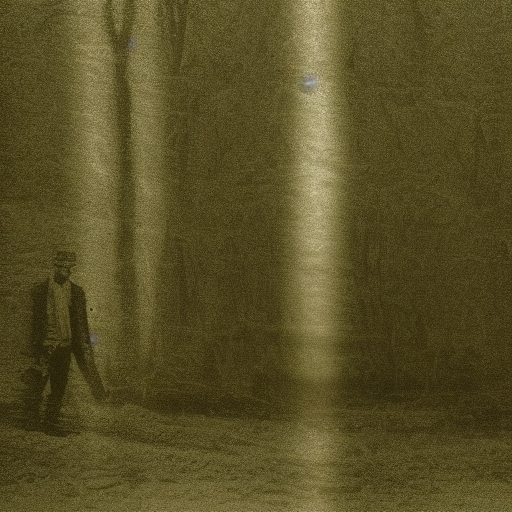

In [ ]:
pil_image